# MODEL FITTING FOR TRAFFIC DETECTION

## STEP 1: TRAIN MODEL
## [STEP 2 : (POST-TRAINING) MODEL INFERENCE](#step2)

In [3]:
# !pip install ultralytics #Disable warnings in the notebook to maintain clean output cells

ERROR: Invalid requirement: 'ultralytics#'


In [4]:
# Disable warnings in the notebook to maintain clean output cells
import warnings
warnings.filterwarnings('ignore')

# Import necessary libraries
import os
import shutil
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns
import cv2
import yaml
from PIL import Image
from ultralytics import YOLO
from IPython.display import Video

In [5]:
# Configure the visual appearance of Seaborn plots
sns.set(rc={'axes.facecolor': '#eae8fa'}, style='darkgrid')

In [7]:
# Load a pretrained YOLOv8n model from Ultralytics
model = YOLO('yolov8n.pt')

100%|██████████████████████████████████████| 6.25M/6.25M [00:00<00:00, 62.1MB/s]


In [8]:
notebook_path = os.getcwd()
print(notebook_path)

/Users/kakuryu/my_project_dir/Traffic Detection



image 1/1 /Users/kakuryu/my_project_dir/Traffic Detection/sample_image.jpg: 384x640 5 cars, 54.9ms
Speed: 1.6ms preprocess, 54.9ms inference, 0.9ms postprocess per image at shape (1, 3, 384, 640)


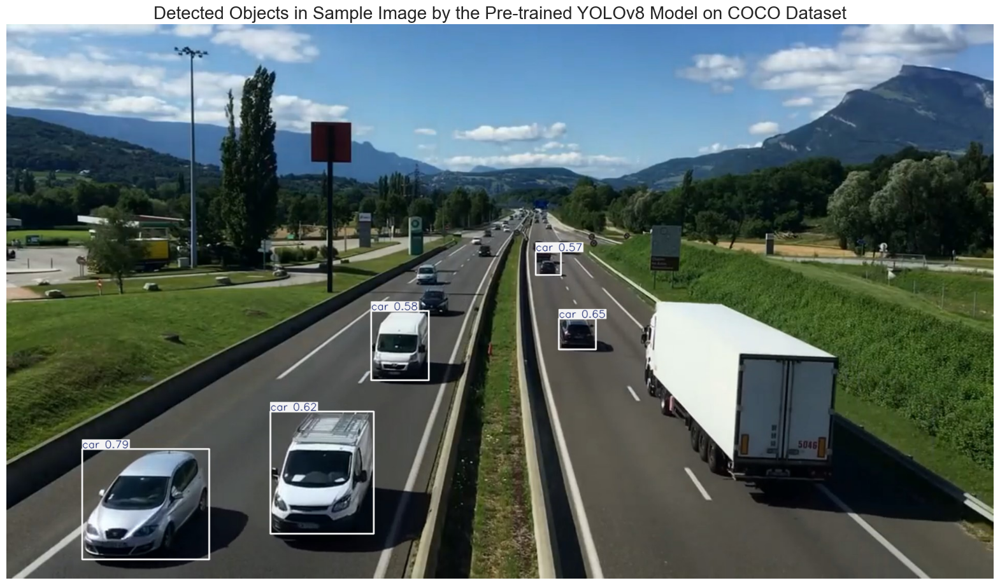

In [9]:
# Path to the image file
image_path = '/Users/kakuryu/my_project_dir/Traffic Detection/sample_image.jpg'

# Perform inference on the provided image(s)
results = model.predict(source=image_path, 
                        imgsz=640,  # Resize image to 640x640 (the size pf images the model was trained on)
                        conf=0.5)   # Confidence threshold: 50% (only detections above 50% confidence will be considered)

# Annotate and convert image to numpy array
sample_image = results[0].plot(line_width=2)

# Convert the color of the image from BGR to RGB for correct color representation in matplotlib
sample_image = cv2.cvtColor(sample_image, cv2.COLOR_BGR2RGB)

# Display annotated image
plt.figure(figsize=(20,15))
plt.imshow(sample_image)
plt.title('Detected Objects in Sample Image by the Pre-trained YOLOv8 Model on COCO Dataset', fontsize=20)
plt.axis('off')
plt.show()


image 1/1 /Users/kakuryu/my_project_dir/Traffic Detection/sample_image2.jpg: 544x640 4 cars, 84.5ms
Speed: 5.5ms preprocess, 84.5ms inference, 0.6ms postprocess per image at shape (1, 3, 544, 640)


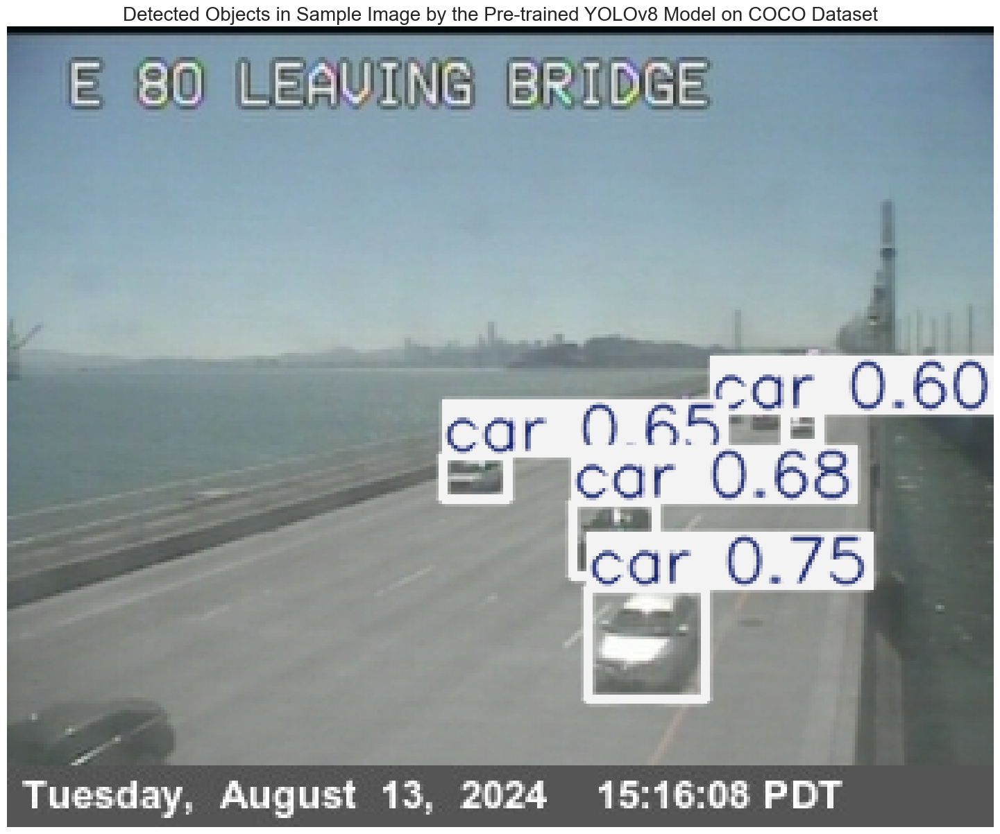

In [30]:
# Path to the image file
image_path = '/Users/kakuryu/my_project_dir/Traffic Detection/sample_image2.jpg'

# Perform inference on the provided image(s)
results1 = model.predict(source=image_path, 
                        imgsz=640,  # Resize image to 640x640 (the size pf images the model was trained on)
                        conf=0.5)   # Confidence threshold: 50% (only detections above 50% confidence will be considered)

# Annotate and convert image to numpy array
sample_image = results1[0].plot(line_width=2)

# Convert the color of the image from BGR to RGB for correct color representation in matplotlib
sample_image = cv2.cvtColor(sample_image, cv2.COLOR_BGR2RGB)

# Display annotated image
plt.figure(figsize=(20,15))
plt.imshow(sample_image)
plt.title('Detected Objects in Sample Image by the Pre-trained YOLOv8 Model on COCO Dataset', fontsize=20)
plt.axis('off')
plt.show()


image 1/1 /Users/kakuryu/my_project_dir/Traffic Detection/images/sample_image3.jpg: 544x640 3 cars, 84.8ms
Speed: 4.5ms preprocess, 84.8ms inference, 0.3ms postprocess per image at shape (1, 3, 544, 640)


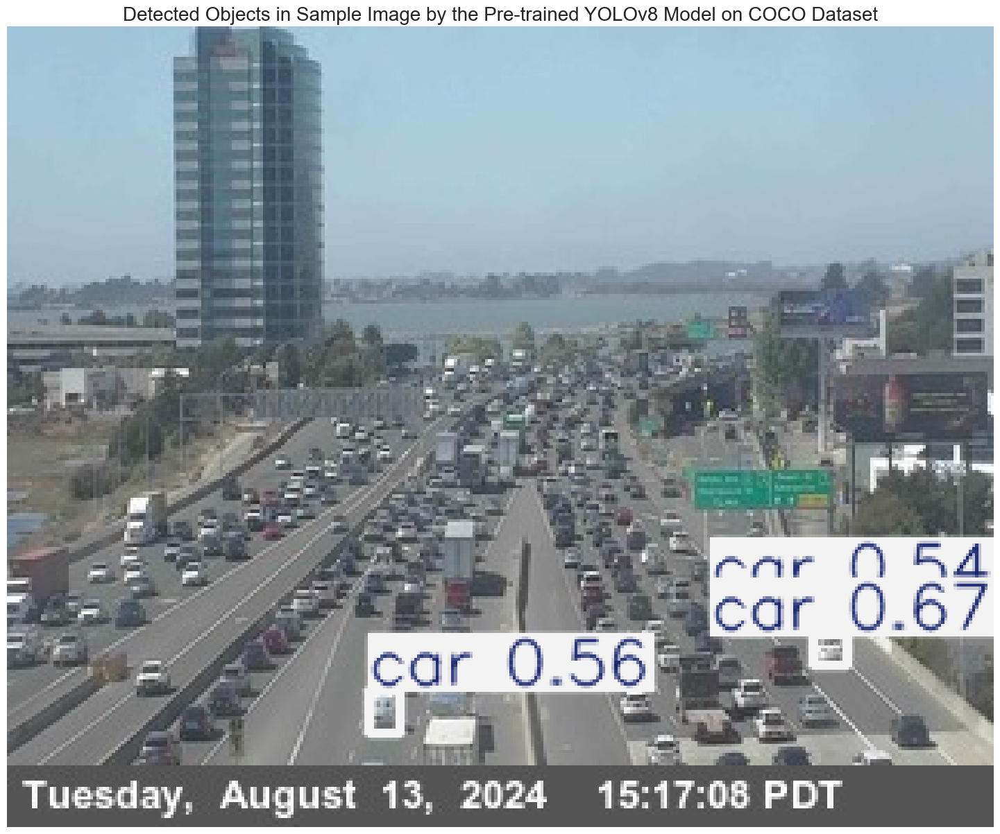

In [31]:
# Path to the image file
image_path = '/Users/kakuryu/my_project_dir/Traffic Detection/images/sample_image3.jpg'

# Perform inference on the provided image(s)
results2 = model.predict(source=image_path, 
                        imgsz=640,  # Resize image to 640x640 (the size pf images the model was trained on)
                        conf=0.5)   # Confidence threshold: 50% (only detections above 50% confidence will be considered)

# Annotate and convert image to numpy array
sample_image = results2[0].plot(line_width=2)

# Convert the color of the image from BGR to RGB for correct color representation in matplotlib
sample_image = cv2.cvtColor(sample_image, cv2.COLOR_BGR2RGB)

# Display annotated image
plt.figure(figsize=(20,15))
plt.imshow(sample_image)
plt.title('Detected Objects in Sample Image by the Pre-trained YOLOv8 Model on COCO Dataset', fontsize=20)
plt.axis('off')
plt.show()


image 1/1 /Users/kakuryu/my_project_dir/Traffic Detection/images/sample_image4.jpg: 544x640 1 car, 78.3ms
Speed: 4.4ms preprocess, 78.3ms inference, 0.6ms postprocess per image at shape (1, 3, 544, 640)


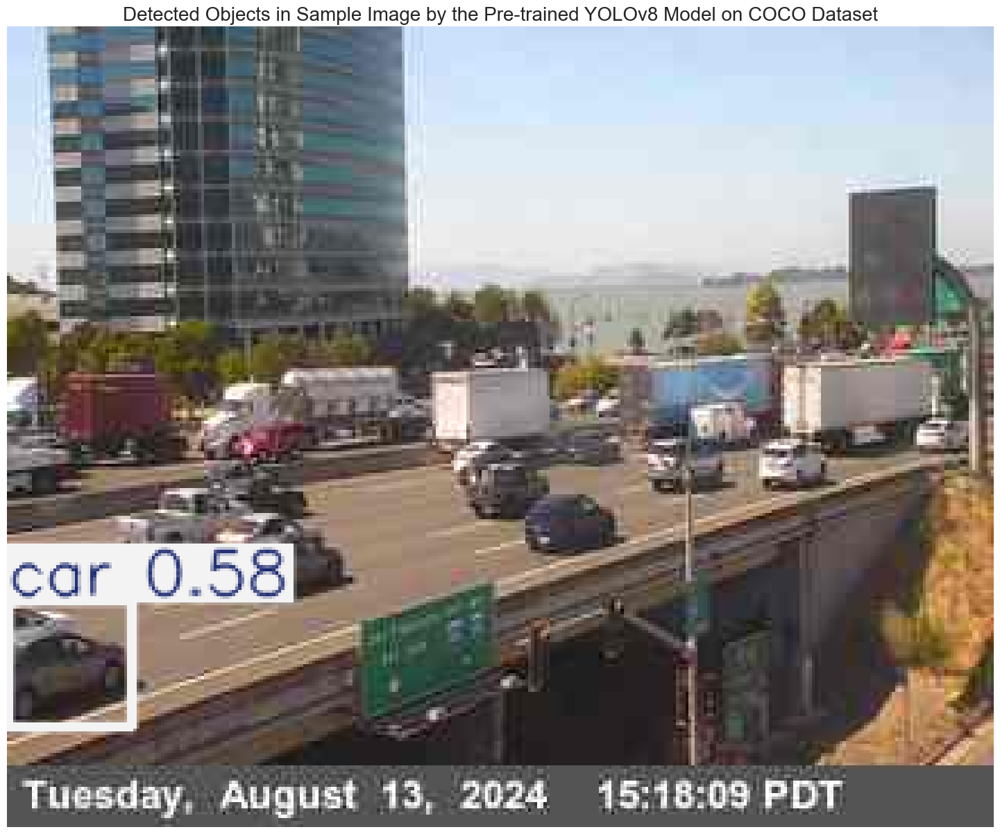

In [32]:
# Path to the image file
image_path = '/Users/kakuryu/my_project_dir/Traffic Detection/images/sample_image4.jpg'

# Perform inference on the provided image(s)
results3 = model.predict(source=image_path, 
                        imgsz=640,  # Resize image to 640x640 (the size pf images the model was trained on)
                        conf=0.5)   # Confidence threshold: 50% (only detections above 50% confidence will be considered)

# Annotate and convert image to numpy array
sample_image = results3[0].plot(line_width=2)

# Convert the color of the image from BGR to RGB for correct color representation in matplotlib
sample_image = cv2.cvtColor(sample_image, cv2.COLOR_BGR2RGB)

# Display annotated image
plt.figure(figsize=(20,15))
plt.imshow(sample_image)
plt.title('Detected Objects in Sample Image by the Pre-trained YOLOv8 Model on COCO Dataset', fontsize=20)
plt.axis('off')
plt.show()

In [67]:
# Define the dataset_path
dataset_path = '/Users/kakuryu/my_project_dir/Traffic Detection'

# Set the path to the YAML file
yaml_file_path = os.path.join(dataset_path, 'data.yaml')

# Load and print the contents of the YAML file
with open(yaml_file_path, 'r') as file:
    yaml_content = yaml.load(file, Loader=yaml.FullLoader)
    print(yaml.dump(yaml_content, default_flow_style=False))

names:
- Vehicle
nc: 1
roboflow:
  license: CC BY 4.0
  project: vehicle_detection_yolov8
  url: https://universe.roboflow.com/farzad/vehicle_detection_yolov8/dataset/3
  version: 3
  workspace: farzad
train: ../train/images
val: ../valid/images



In [74]:
# Set paths for training and validation image sets
train_images_path = os.path.join(dataset_path, 'train', 'images')
valid_images_path = os.path.join(dataset_path, 'valid', 'images')

# Initialize counters for the number of images
num_train_images = 0
num_valid_images = 0

# Initialize sets to hold the unique sizes of images
train_image_sizes = set()
valid_image_sizes = set()

# Check train images sizes and count
for filename in os.listdir(train_images_path):
    if filename.endswith('.jpg'):  
        num_train_images += 1
        imageimg.siz_path = os.path.join(train_images_path, filename)
        with Image.open(image_path) as img:
            train_image_sizes.add(img.size)

# Check validation images sizes and count
for filename in os.listdir(valid_images_path):
    if filename.endswith('.jpg'): 
        num_valid_images += 1
        image_path = os.path.join(valid_images_path, filename)
        with Image.open(image_path) as img:
            valid_image_sizes.add(img.size)

# Print the results
print(f"Number of training images: {num_train_images}")
print(f"Number of validation images: {num_valid_images}")

# Check if all images in training set have the same size
if len(train_image_sizes) == 1:
    print(f"All training images have the same size: {train_image_sizes.pop()}")
else:
    print("Training images have varying sizes.")

# Check if all images in validation set have the same size
if len(valid_image_sizes) == 1:
    print(f"All validation images have the same size: {valid_image_sizes.pop()}")
else:
    print("Validation images have varying sizes.")

Number of training images: 536
Number of validation images: 90
All training images have the same size: (640, 640)
All validation images have the same size: (640, 640)


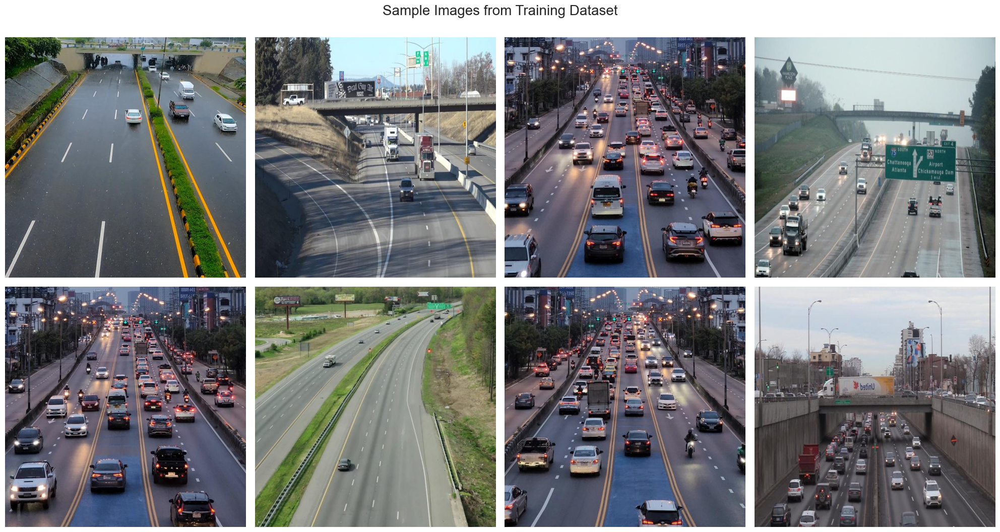

In [75]:
# List all jpg images in the directory
image_files = [file for file in os.listdir(train_images_path) if file.endswith('.jpg')]

# Select 8 images at equal intervals
num_images = len(image_files)
selected_images = [image_files[i] for i in range(0, num_images, num_images // 8)]

# Create a 2x4 subplot
fig, axes = plt.subplots(2, 4, figsize=(20, 11))

# Display each of the selected images
for ax, img_file in zip(axes.ravel(), selected_images):
    img_path = os.path.join(train_images_path, img_file)
    image = Image.open(img_path)
    ax.imshow(image)
    ax.axis('off')  

plt.suptitle('Sample Images from Training Dataset', fontsize=20)
plt.tight_layout()
plt.show()

In [86]:
# Train the model on our custom dataset
results = model.train(
    data=yaml_file_path,     # Path to the dataset configuration file
    epochs=100,              # Number of epochs to train for
    imgsz=640,               # Size of input images as integer
    device='cpu',                # Device to run on, i.e. cuda device=0 
    patience=50,             # Epochs to wait for no observable improvement for early stopping of training
    batch=32,                # Number of images per batch
    optimizer='auto',        # Optimizer to use, choices=[SGD, Adam, Adamax, AdamW, NAdam, RAdam, RMSProp, auto]
    lr0=0.0001,              # Initial learning rate 
    lrf=0.1,                 # Final learning rate (lr0 * lrf)
    dropout=0.1,             # Use dropout regularization
    seed=0                   # Random seed for reproducibility
)

Ultralytics YOLOv8.2.77 🚀 Python-3.11.8 torch-2.3.1 CPU (Apple M2)
engine/trainer: task=detect, mode=train, model=yolov8n.pt, data=/Users/kakuryu/my_project_dir/Traffic Detection/data.yaml, epochs=100, time=None, patience=50, batch=32, imgsz=640, save=True, save_period=-1, cache=False, device=cpu, workers=8, project=None, name=train, exist_ok=False, pretrained=True, optimizer=auto, verbose=True, seed=0, deterministic=True, single_cls=False, rect=False, cos_lr=False, close_mosaic=10, resume=False, amp=True, fraction=1.0, profile=False, freeze=None, multi_scale=False, overlap_mask=True, mask_ratio=4, dropout=0.1, val=True, split=val, save_json=False, save_hybrid=False, conf=None, iou=0.7, max_det=300, half=False, dnn=False, plots=True, source=None, vid_stride=1, stream_buffer=False, visualize=False, augment=False, agnostic_nms=False, classes=None, retina_masks=False, embed=None, show=False, save_frames=False, save_txt=False, save_conf=False, save_crop=False, show_labels=True, show_conf=T

train: Scanning /Users/kakuryu/my_project_dir/Traffic Detection/train/labels... 

train: New cache created: /Users/kakuryu/my_project_dir/Traffic Detection/train/labels.cache



val: Scanning /Users/kakuryu/my_project_dir/Traffic Detection/valid/labels... 90

val: New cache created: /Users/kakuryu/my_project_dir/Traffic Detection/valid/labels.cache
Plotting labels to runs/detect/train/labels.jpg... 


optimizer: 'optimizer=auto' found, ignoring 'lr0=0.0001' and 'momentum=0.937' and determining best 'optimizer', 'lr0' and 'momentum' automatically... 
optimizer: AdamW(lr=0.002, momentum=0.9) with parameter groups 57 weight(decay=0.0), 64 weight(decay=0.0005), 63 bias(decay=0.0)
Image sizes 640 train, 640 val
Using 0 dataloader workers
Logging results to runs/detect/train
Starting training for 100 epochs...

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      1/100         0G      2.342       2.82      1.791        363        640: 1
                 Class     Images  Instances      Box(P          R      mAP50  m

                   all         90        937    0.00319     0.0918    0.00206   0.000652



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      2/100         0G      1.502      1.297       1.19        409        640: 1
                 Class     Images  Instances      Box(P          R      mAP50  m

                   all         90        937    0.00567      0.163    0.00849    0.00416

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size



      3/100         0G      1.299     0.9904       1.07        362        640: 1
                 Class     Images  Instances      Box(P          R      mAP50  m

                   all         90        937      0.753      0.329       0.41      0.227

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size



      4/100         0G      1.208     0.8827       1.03        525        640: 1
                 Class     Images  Instances      Box(P          R      mAP50  m

                   all         90        937       0.84      0.778      0.843      0.542

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size



      5/100         0G      1.182     0.8336       1.02        401        640: 1
                 Class     Images  Instances      Box(P          R      mAP50  m

                   all         90        937      0.845      0.845      0.903      0.597



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      6/100         0G       1.16     0.8033      1.012        432        640: 1
                 Class     Images  Instances      Box(P          R      mAP50  m

                   all         90        937      0.883      0.862      0.935      0.637

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size



      7/100         0G      1.124     0.7843     0.9941        357        640: 1
                 Class     Images  Instances      Box(P          R      mAP50  m

                   all         90        937      0.819      0.927      0.925      0.643



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      8/100         0G      1.106     0.7637     0.9934        389        640: 1
                 Class     Images  Instances      Box(P          R      mAP50  m

                   all         90        937      0.797      0.905      0.921      0.639

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size



      9/100         0G      1.108      0.728     0.9935        274        640: 1
                 Class     Images  Instances      Box(P          R      mAP50  m

                   all         90        937      0.846      0.926      0.949       0.66

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size



     10/100         0G      1.108      0.718      0.991        373        640: 1
                 Class     Images  Instances      Box(P          R      mAP50  m

                   all         90        937      0.865      0.896      0.953      0.651

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size



     11/100         0G      1.093      0.702     0.9873        325        640: 1
                 Class     Images  Instances      Box(P          R      mAP50  m

                   all         90        937      0.875      0.914      0.947      0.659

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size



     12/100         0G       1.09     0.6643     0.9803        360        640: 1
                 Class     Images  Instances      Box(P          R      mAP50  m

                   all         90        937      0.873      0.904      0.958      0.684

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size



     13/100         0G      1.062     0.6459     0.9711        348        640: 1
                 Class     Images  Instances      Box(P          R      mAP50  m

                   all         90        937      0.902      0.894       0.96      0.695

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size



     14/100         0G      1.061     0.6592     0.9733        392        640: 1
                 Class     Images  Instances      Box(P          R      mAP50  m

                   all         90        937      0.912      0.909      0.968      0.692

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size



     15/100         0G      1.051     0.6472      0.973        321        640: 1
                 Class     Images  Instances      Box(P          R      mAP50  m

                   all         90        937      0.873      0.918      0.965       0.69

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size



     16/100         0G      1.053     0.6285     0.9601        370        640: 1
                 Class     Images  Instances      Box(P          R      mAP50  m

                   all         90        937      0.887      0.916      0.959      0.675

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size



     17/100         0G      1.061     0.6292     0.9672        326        640: 1
                 Class     Images  Instances      Box(P          R      mAP50  m

                   all         90        937      0.892       0.92      0.962      0.689



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     18/100         0G      1.027     0.6104     0.9615        282        640: 1
                 Class     Images  Instances      Box(P          R      mAP50  m

                   all         90        937       0.88      0.906      0.957      0.685

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size



     19/100         0G      1.024     0.5981      0.958        389        640: 1
                 Class     Images  Instances      Box(P          R      mAP50  m

                   all         90        937      0.875      0.936      0.962      0.703

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size



     20/100         0G      1.019     0.5883     0.9591        324        640: 1
                 Class     Images  Instances      Box(P          R      mAP50  m

                   all         90        937      0.917      0.899      0.966      0.692



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     21/100         0G      1.023     0.5884     0.9588        363        640: 1
                 Class     Images  Instances      Box(P          R      mAP50  m

                   all         90        937       0.89      0.918      0.962      0.686



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     22/100         0G      1.028     0.5769     0.9563        407        640: 1
                 Class     Images  Instances      Box(P          R      mAP50  m

                   all         90        937      0.881      0.933      0.958      0.682

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size



     23/100         0G       1.01     0.5738     0.9548        193        640: 1
                 Class     Images  Instances      Box(P          R      mAP50  m

                   all         90        937      0.878       0.92      0.965      0.707



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     24/100         0G      1.006     0.5591      0.947        307        640: 1
                 Class     Images  Instances      Box(P          R      mAP50  m

                   all         90        937      0.903      0.928      0.967      0.696

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size



     25/100         0G     0.9932     0.5653     0.9467        398        640: 1
                 Class     Images  Instances      Box(P          R      mAP50  m

                   all         90        937      0.889      0.928      0.964      0.691

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size



     26/100         0G      1.013     0.5698      0.947        376        640: 1
                 Class     Images  Instances      Box(P          R      mAP50  m

                   all         90        937      0.913      0.902      0.968      0.693

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size



     27/100         0G     0.9825     0.5482     0.9431        352        640: 1
                 Class     Images  Instances      Box(P          R      mAP50  m

                   all         90        937      0.911      0.916      0.971      0.719

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size



     28/100         0G     0.9754     0.5476     0.9449        405        640: 1
                 Class     Images  Instances      Box(P          R      mAP50  m

                   all         90        937        0.9      0.915      0.965      0.714

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size



     29/100         0G      1.007     0.5627     0.9491        275        640: 1
                 Class     Images  Instances      Box(P          R      mAP50  m

                   all         90        937      0.884      0.925      0.964      0.687

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size



     30/100         0G     0.9812     0.5455     0.9481        437        640: 1
                 Class     Images  Instances      Box(P          R      mAP50  m

                   all         90        937      0.905      0.914      0.969      0.715

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size



     31/100         0G     0.9726     0.5477     0.9404        302        640: 1
                 Class     Images  Instances      Box(P          R      mAP50  m

                   all         90        937      0.897       0.94       0.97      0.712

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size



     32/100         0G     0.9731     0.5404     0.9432        298        640: 1
                 Class     Images  Instances      Box(P          R      mAP50  m

                   all         90        937      0.895      0.942      0.974      0.718

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size



     33/100         0G     0.9774     0.5419     0.9421        274        640: 1
                 Class     Images  Instances      Box(P          R      mAP50  m

                   all         90        937      0.896      0.939      0.975      0.711

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size



     34/100         0G     0.9706     0.5569      0.938        321        640: 1
                 Class     Images  Instances      Box(P          R      mAP50  m

                   all         90        937      0.903      0.924      0.973      0.709

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size



     35/100         0G     0.9709      0.538     0.9367        344        640: 1
                 Class     Images  Instances      Box(P          R      mAP50  m

                   all         90        937      0.857       0.94      0.942      0.677

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size



     36/100         0G     0.9808     0.5466     0.9412        400        640: 1
                 Class     Images  Instances      Box(P          R      mAP50  m

                   all         90        937      0.907      0.931      0.969      0.705

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size



     37/100         0G     0.9664     0.5314     0.9384        341        640: 1
                 Class     Images  Instances      Box(P          R      mAP50  m

                   all         90        937      0.922      0.919       0.97      0.703

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size



     38/100         0G     0.9513     0.5291     0.9362        366        640: 1
                 Class     Images  Instances      Box(P          R      mAP50  m

                   all         90        937      0.905      0.931      0.971      0.721

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size



     39/100         0G     0.9485     0.5222     0.9348        411        640: 1
                 Class     Images  Instances      Box(P          R      mAP50  m

                   all         90        937      0.919      0.926      0.972      0.728



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     40/100         0G      0.934     0.5122     0.9242        354        640: 1
                 Class     Images  Instances      Box(P          R      mAP50  m

                   all         90        937      0.923      0.923      0.976      0.729

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size



     41/100         0G     0.9423     0.5029     0.9341        376        640: 1
                 Class     Images  Instances      Box(P          R      mAP50  m

                   all         90        937      0.926      0.924      0.973       0.72

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size



     42/100         0G     0.9386     0.5161     0.9266        394        640: 1
                 Class     Images  Instances      Box(P          R      mAP50  m

                   all         90        937      0.919       0.93      0.975      0.724

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size



     43/100         0G     0.9388     0.5116     0.9351        423        640: 1
                 Class     Images  Instances      Box(P          R      mAP50  m

                   all         90        937      0.906      0.916      0.969       0.72

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size



     44/100         0G     0.9437     0.5207     0.9304        321        640: 1
                 Class     Images  Instances      Box(P          R      mAP50  m

                   all         90        937      0.918      0.928       0.97      0.722

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size



     45/100         0G     0.9427     0.5071     0.9223        294        640: 1
                 Class     Images  Instances      Box(P          R      mAP50  m

                   all         90        937      0.893      0.935      0.971      0.722

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size



     46/100         0G     0.9398     0.5192     0.9318        370        640: 1
                 Class     Images  Instances      Box(P          R      mAP50  m

                   all         90        937      0.922      0.923      0.968      0.726

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size



     47/100         0G     0.9191     0.4975     0.9234        327        640: 1
                 Class     Images  Instances      Box(P          R      mAP50  m

                   all         90        937      0.953      0.905      0.978      0.717



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     48/100         0G     0.9374     0.4918     0.9325        429        640: 1
                 Class     Images  Instances      Box(P          R      mAP50  m

                   all         90        937      0.888      0.941      0.967      0.722

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size



     49/100         0G     0.9432     0.4989      0.933        356        640: 1
                 Class     Images  Instances      Box(P          R      mAP50  m

                   all         90        937      0.918      0.934      0.976      0.726

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size



     50/100         0G     0.9313     0.4991      0.926        292        640: 1
                 Class     Images  Instances      Box(P          R      mAP50  m

                   all         90        937      0.933      0.916      0.973      0.725

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size



     51/100         0G     0.9244     0.4867     0.9286        389        640: 1
                 Class     Images  Instances      Box(P          R      mAP50  m

                   all         90        937        0.9      0.937      0.973      0.729



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     52/100         0G     0.9089     0.4803     0.9207        367        640: 1
                 Class     Images  Instances      Box(P          R      mAP50  m

                   all         90        937      0.902      0.926      0.972      0.724



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     53/100         0G     0.9091     0.4933     0.9221        356        640: 1
                 Class     Images  Instances      Box(P          R      mAP50  m

                   all         90        937        0.9      0.927       0.97      0.724

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size



     54/100         0G     0.9184     0.4829     0.9199        356        640: 1
                 Class     Images  Instances      Box(P          R      mAP50  m

                   all         90        937      0.898      0.922      0.967      0.704

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size



     55/100         0G     0.9095     0.4775     0.9262        379        640: 1
                 Class     Images  Instances      Box(P          R      mAP50  m

                   all         90        937      0.896      0.928      0.971      0.724

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size



     56/100         0G     0.9113     0.4891     0.9232        380        640: 1
                 Class     Images  Instances      Box(P          R      mAP50  m

                   all         90        937      0.923      0.916      0.976      0.729

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size



     57/100         0G     0.9117     0.4863     0.9206        317        640: 1
                 Class     Images  Instances      Box(P          R      mAP50  m

                   all         90        937      0.903      0.919      0.967      0.733

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size



     58/100         0G     0.8981     0.4759     0.9127        427        640: 1
                 Class     Images  Instances      Box(P          R      mAP50  m

                   all         90        937      0.928      0.917      0.974      0.732

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size



     59/100         0G     0.8998     0.4834     0.9219        324        640: 1
                 Class     Images  Instances      Box(P          R      mAP50  m

                   all         90        937      0.915      0.918      0.969       0.73

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size



     60/100         0G     0.8941     0.4735     0.9163        383        640: 1
                 Class     Images  Instances      Box(P          R      mAP50  m

                   all         90        937      0.899      0.929      0.965       0.72

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size



     61/100         0G     0.8911     0.4731     0.9151        276        640: 1
                 Class     Images  Instances      Box(P          R      mAP50  m

                   all         90        937      0.912      0.914      0.968      0.726

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size



     62/100         0G     0.8868     0.4739     0.9173        290        640: 1
                 Class     Images  Instances      Box(P          R      mAP50  m

                   all         90        937      0.897      0.936      0.971      0.722

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size



     63/100         0G     0.8876     0.4706     0.9123        344        640: 1
                 Class     Images  Instances      Box(P          R      mAP50  m

                   all         90        937      0.921      0.915       0.97      0.724

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size



     64/100         0G     0.8885     0.4697     0.9134        356        640: 1
                 Class     Images  Instances      Box(P          R      mAP50  m

                   all         90        937        0.9      0.943      0.972      0.732

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size



     65/100         0G     0.8755      0.462     0.9139        282        640: 1
                 Class     Images  Instances      Box(P          R      mAP50  m

                   all         90        937      0.899      0.945      0.966      0.729

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size



     66/100         0G     0.8762     0.4597     0.9082        372        640: 1
                 Class     Images  Instances      Box(P          R      mAP50  m

                   all         90        937      0.889      0.953      0.969      0.726

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size



     67/100         0G     0.8713     0.4523     0.9137        290        640: 1
                 Class     Images  Instances      Box(P          R      mAP50  m

                   all         90        937      0.912      0.939      0.973       0.73

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size



     68/100         0G     0.8822     0.4667     0.9177        347        640: 1
                 Class     Images  Instances      Box(P          R      mAP50  m

                   all         90        937      0.896      0.922      0.958      0.715

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size



     69/100         0G     0.8828      0.466     0.9135        342        640: 1
                 Class     Images  Instances      Box(P          R      mAP50  m

                   all         90        937      0.897      0.941      0.968      0.727

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size



     70/100         0G     0.8954     0.4654     0.9173        191        640: 1
                 Class     Images  Instances      Box(P          R      mAP50  m

                   all         90        937      0.888       0.94      0.963       0.72



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     71/100         0G     0.8667     0.4589     0.9107        356        640: 1
                 Class     Images  Instances      Box(P          R      mAP50  m

                   all         90        937       0.91      0.925      0.972      0.726

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size



     72/100         0G     0.8759     0.4523     0.9124        326        640: 1
                 Class     Images  Instances      Box(P          R      mAP50  m

                   all         90        937       0.91      0.938      0.974      0.732



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     73/100         0G     0.8659     0.4599     0.9049        439        640: 1
                 Class     Images  Instances      Box(P          R      mAP50  m

                   all         90        937      0.925      0.923      0.977      0.737



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     74/100         0G     0.8629     0.4507     0.9096        268        640: 1
                 Class     Images  Instances      Box(P          R      mAP50  m

                   all         90        937      0.917      0.921      0.971       0.74



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     75/100         0G     0.8602     0.4459     0.9032        337        640: 1
                 Class     Images  Instances      Box(P          R      mAP50  m

                   all         90        937      0.904      0.939      0.969      0.734

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size



     76/100         0G     0.8582     0.4534     0.9015        387        640: 1
                 Class     Images  Instances      Box(P          R      mAP50  m

                   all         90        937      0.883      0.942      0.966      0.709



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     77/100         0G     0.8602     0.4524     0.9071        316        640: 1
                 Class     Images  Instances      Box(P          R      mAP50  m

                   all         90        937      0.919       0.93      0.967      0.731

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size



     78/100         0G     0.8577     0.4504     0.9022        379        640: 1
                 Class     Images  Instances      Box(P          R      mAP50  m

                   all         90        937      0.899       0.94       0.97      0.713

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size



     79/100         0G     0.8569     0.4508     0.9054        217        640: 1
                 Class     Images  Instances      Box(P          R      mAP50  m

                   all         90        937      0.905      0.945      0.971      0.733



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     80/100         0G     0.8528     0.4388     0.9073        293        640: 1
                 Class     Images  Instances      Box(P          R      mAP50  m

                   all         90        937      0.943      0.903      0.973      0.736



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     81/100         0G      0.845     0.4403     0.9051        240        640: 1
                 Class     Images  Instances      Box(P          R      mAP50  m

                   all         90        937      0.917      0.928      0.972      0.736

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size



     82/100         0G      0.854     0.4414     0.9082        335        640: 1
                 Class     Images  Instances      Box(P          R      mAP50  m

                   all         90        937      0.921      0.928      0.974      0.732



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     83/100         0G     0.8402     0.4348     0.8939        321        640: 1
                 Class     Images  Instances      Box(P          R      mAP50  m

                   all         90        937       0.92       0.93      0.971       0.74



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     84/100         0G     0.8331     0.4328     0.8992        414        640: 1
                 Class     Images  Instances      Box(P          R      mAP50  m

                   all         90        937      0.918      0.938       0.97      0.739

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size



     85/100         0G     0.8359     0.4308     0.8995        303        640: 1
                 Class     Images  Instances      Box(P          R      mAP50  m

                   all         90        937      0.919      0.926      0.976      0.736

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size



     86/100         0G     0.8335     0.4272     0.9027        267        640: 1
                 Class     Images  Instances      Box(P          R      mAP50  m

                   all         90        937      0.886      0.961      0.964      0.734



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     87/100         0G     0.8486      0.436     0.9048        487        640: 1
                 Class     Images  Instances      Box(P          R      mAP50  m

                   all         90        937      0.919      0.927      0.974       0.74



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     88/100         0G     0.8395     0.4394     0.8988        357        640: 1
                 Class     Images  Instances      Box(P          R      mAP50  m

                   all         90        937       0.92      0.918      0.965      0.733

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size



     89/100         0G     0.8266     0.4216     0.9001        318        640: 1
                 Class     Images  Instances      Box(P          R      mAP50  m

                   all         90        937      0.903      0.948       0.97      0.735



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     90/100         0G     0.8116     0.4252     0.8984        388        640: 1
                 Class     Images  Instances      Box(P          R      mAP50  m

                   all         90        937      0.914      0.933      0.971      0.735
Closing dataloader mosaic

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size



     91/100         0G     0.8284     0.4214     0.9029        259        640: 1
                 Class     Images  Instances      Box(P          R      mAP50  m

                   all         90        937      0.908      0.927      0.964      0.734

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size



     92/100         0G     0.8144      0.405      0.895        209        640: 1
                 Class     Images  Instances      Box(P          R      mAP50  m

                   all         90        937      0.914      0.933      0.972      0.736

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size



     93/100         0G     0.8113     0.4029     0.8958        165        640: 1
                 Class     Images  Instances      Box(P          R      mAP50  m

                   all         90        937      0.906      0.938      0.969      0.731



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     94/100         0G     0.7968     0.4008     0.8972        286        640: 1
                 Class     Images  Instances      Box(P          R      mAP50  m

                   all         90        937      0.926      0.925      0.971      0.737



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     95/100         0G      0.804     0.3984     0.8933        304        640: 1
                 Class     Images  Instances      Box(P          R      mAP50  m

                   all         90        937      0.893      0.955      0.971      0.737



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     96/100         0G     0.7838     0.3876     0.8884        142        640: 1
                 Class     Images  Instances      Box(P          R      mAP50  m

                   all         90        937      0.904      0.946       0.97      0.736



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     97/100         0G     0.7974     0.3918      0.891        191        640: 1
                 Class     Images  Instances      Box(P          R      mAP50  m

                   all         90        937      0.916       0.93      0.974      0.737



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     98/100         0G     0.7848     0.3862     0.8907        309        640: 1
                 Class     Images  Instances      Box(P          R      mAP50  m

                   all         90        937      0.917      0.937      0.976       0.74



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     99/100         0G      0.778     0.3887     0.8849        205        640: 1
                 Class     Images  Instances      Box(P          R      mAP50  m

                   all         90        937      0.919      0.932      0.972      0.737



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    100/100         0G     0.7789     0.3862     0.8896        233        640: 1
                 Class     Images  Instances      Box(P          R      mAP50  m

                   all         90        937      0.917       0.94      0.972      0.739



100 epochs completed in 17.055 hours.
Optimizer stripped from runs/detect/train/weights/last.pt, 6.3MB
Optimizer stripped from runs/detect/train/weights/best.pt, 6.3MB

Validating runs/detect/train/weights/best.pt...
Ultralytics YOLOv8.2.77 🚀 Python-3.11.8 torch-2.3.1 CPU (Apple M2)
Model summary (fused): 168 layers, 3,005,843 parameters, 0 gradients, 8.1 GFLOPs


                 Class     Images  Instances      Box(P          R      mAP50  m


                   all         90        937      0.917      0.937      0.976       0.74
Speed: 0.9ms preprocess, 156.3ms inference, 0.0ms loss, 0.3ms postprocess per image
Results saved to runs/detect/train


***
<a id="step2"></a>

## STEP 2 : (POST-TRAINING) MODEL INFERENCE

In [1]:
# Disable warnings in the notebook to maintain clean output cells
import warnings
warnings.filterwarnings('ignore')

# Import necessary libraries
import os
import shutil
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns
import cv2
import yaml
from PIL import Image
from ultralytics import YOLO
from IPython.display import Video

In [11]:
# Define the dataset_path
dataset_path = '/Users/kakuryu/my_project_dir/Traffic Detection'

In [2]:
# Define the path to the directory
post_training_files_path = 'runs/detect/train'

# List the files in the directory
!ls {post_training_files_path}

F1_curve.png                    train_batch0.jpg
PR_curve.png                    train_batch1.jpg
P_curve.png                     train_batch1530.jpg
R_curve.png                     train_batch1531.jpg
args.yaml                       train_batch1532.jpg
confusion_matrix.png            train_batch2.jpg
confusion_matrix_normalized.png val_batch0_labels.jpg
labels.jpg                      val_batch0_pred.jpg
labels_correlogram.jpg          val_batch1_labels.jpg
results.csv                     val_batch1_pred.jpg
results.png                     weights


In [3]:
# Define a function to plot learning curves for loss values
def plot_learning_curve(df, train_loss_col, val_loss_col, title):
    plt.figure(figsize=(12, 5))
    sns.lineplot(data=df, x='epoch', y=train_loss_col, label='Train Loss', color='#141140', linestyle='-', linewidth=2)
    sns.lineplot(data=df, x='epoch', y=val_loss_col, label='Validation Loss', color='orangered', linestyle='--', linewidth=2)
    plt.title(title)
    plt.xlabel('Epochs')
    plt.ylabel('Loss')
    plt.legend()
    plt.show()


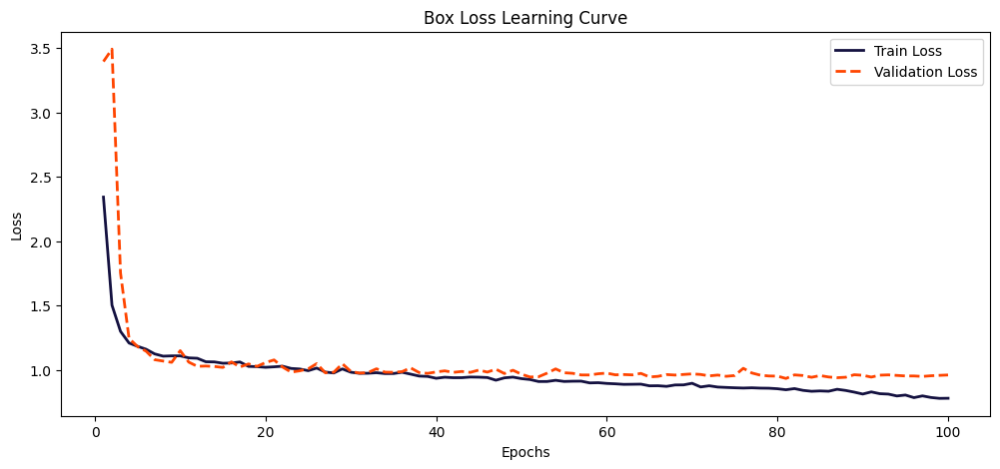

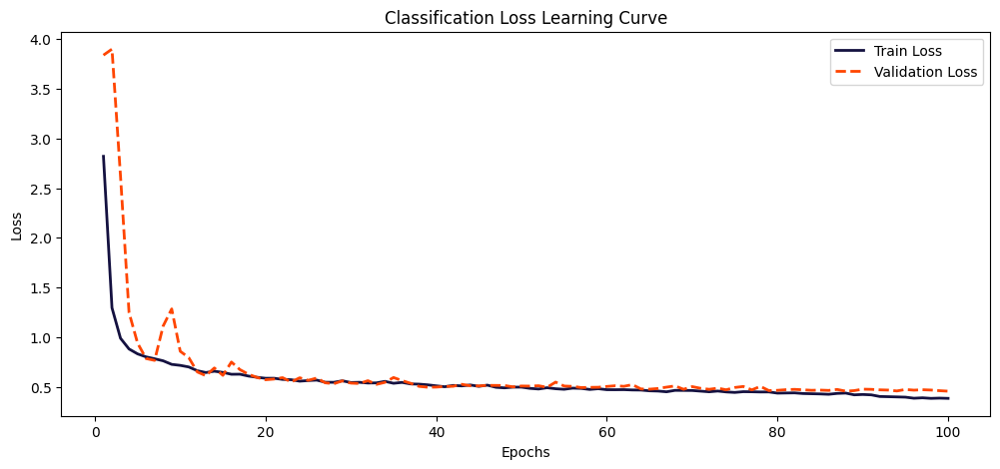

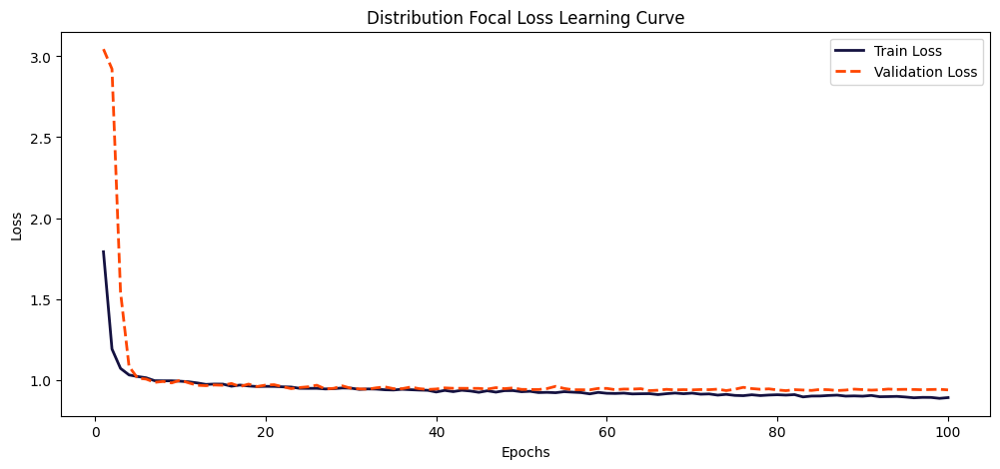

In [4]:
# Create the full file path for 'results.csv' using the directory path and file name
results_csv_path = os.path.join(post_training_files_path, 'results.csv')

# Load the CSV file from the constructed path into a pandas DataFrame
df = pd.read_csv(results_csv_path)

# Remove any leading whitespace from the column names
df.columns = df.columns.str.strip()

# Plot the learning curves for each loss
plot_learning_curve(df, 'train/box_loss', 'val/box_loss', 'Box Loss Learning Curve')
plot_learning_curve(df, 'train/cls_loss', 'val/cls_loss', 'Classification Loss Learning Curve')
plot_learning_curve(df, 'train/dfl_loss', 'val/dfl_loss', 'Distribution Focal Loss Learning Curve')

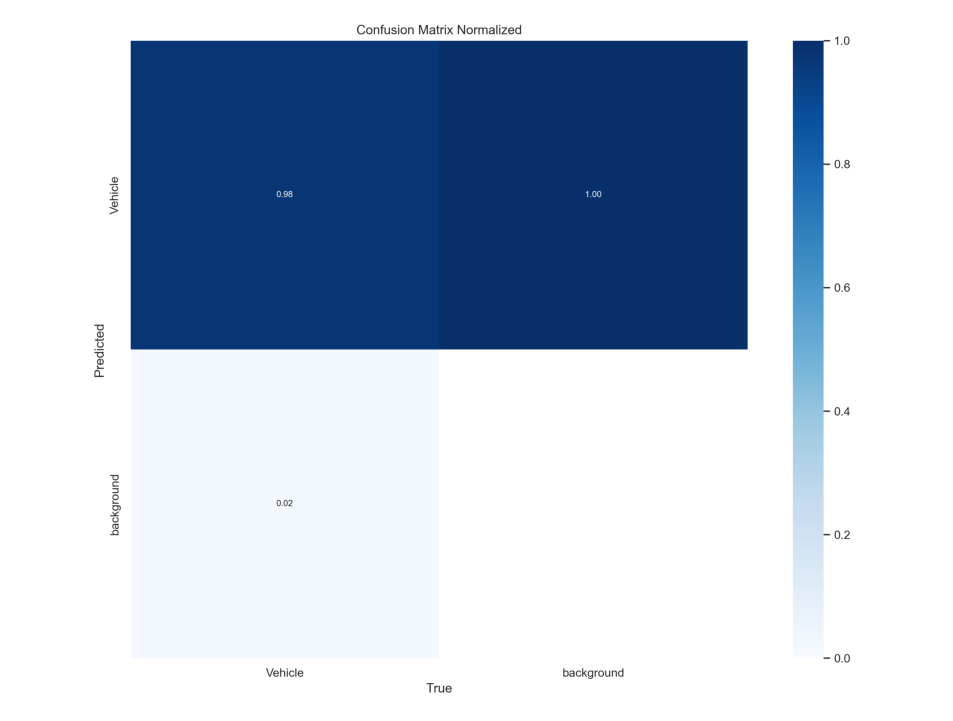

In [5]:
# Construct the path to the normalized confusion matrix image
confusion_matrix_path = os.path.join(post_training_files_path, 'confusion_matrix_normalized.png')

# Read the image using cv2
cm_img = cv2.imread(confusion_matrix_path)

# Convert the image from BGR to RGB color space for accurate color representation with matplotlib
cm_img = cv2.cvtColor(cm_img, cv2.COLOR_BGR2RGB)

# Display the image
plt.figure(figsize=(10, 10), dpi=120)
plt.imshow(cm_img)
plt.axis('off') 
plt.show()

In [8]:
# Construct the path to the best model weights file using os.path.join
best_model_path = os.path.join(post_training_files_path, 'weights/best.pt')

# Load the best model weights into the YOLO model
best_model = YOLO(best_model_path)

# Validate the best model using the validation set with default parameters
metrics = best_model.val(split='val')

Ultralytics YOLOv8.2.77 🚀 Python-3.11.8 torch-2.3.1 CPU (Apple M2)
Model summary (fused): 168 layers, 3,005,843 parameters, 0 gradients, 8.1 GFLOPs


val: Scanning /Users/kakuryu/my_project_dir/Traffic Detection/valid/labels.cache
                 Class     Images  Instances      Box(P          R      mAP50  m


                   all         90        937      0.917      0.937      0.976       0.74
Speed: 1.0ms preprocess, 145.3ms inference, 0.0ms loss, 0.3ms postprocess per image
Results saved to runs/detect/val2


In [9]:
# Convert the dictionary to a pandas DataFrame and use the keys as the index
metrics_df = pd.DataFrame.from_dict(metrics.results_dict, orient='index', columns=['Metric Value'])

# Display the DataFrame
metrics_df.round(3)

,Metric Value
metrics/precision(B),0.917
metrics/recall(B),0.937
metrics/mAP50(B),0.976
metrics/mAP50-95(B),0.740
fitness,0.763



image 1/1 /Users/kakuryu/my_project_dir/Traffic Detection/valid/images/14_mp4-24_jpg.rf.57d5fe50d543f58e3b1f761ee53e1aa8.jpg: 640x640 6 Vehicles, 77.1ms
Speed: 1.7ms preprocess, 77.1ms inference, 0.4ms postprocess per image at shape (1, 3, 640, 640)

image 1/1 /Users/kakuryu/my_project_dir/Traffic Detection/valid/images/14_mp4-10_jpg.rf.edf4723435ff483f7d55c474a60be14d.jpg: 640x640 8 Vehicles, 87.5ms
Speed: 0.9ms preprocess, 87.5ms inference, 0.3ms postprocess per image at shape (1, 3, 640, 640)

image 1/1 /Users/kakuryu/my_project_dir/Traffic Detection/valid/images/5_mp4-29_jpg.rf.de506ae3402dafeffb1e6427af894871.jpg: 640x640 18 Vehicles, 72.3ms
Speed: 1.3ms preprocess, 72.3ms inference, 0.3ms postprocess per image at shape (1, 3, 640, 640)

image 1/1 /Users/kakuryu/my_project_dir/Traffic Detection/valid/images/5_mp4-5_jpg.rf.47c7656c79a6cfa7dbabfcaaeef94dea.jpg: 640x640 22 Vehicles, 68.3ms
Speed: 1.5ms preprocess, 68.3ms inference, 0.5ms postprocess per image at shape (1, 3, 640, 64

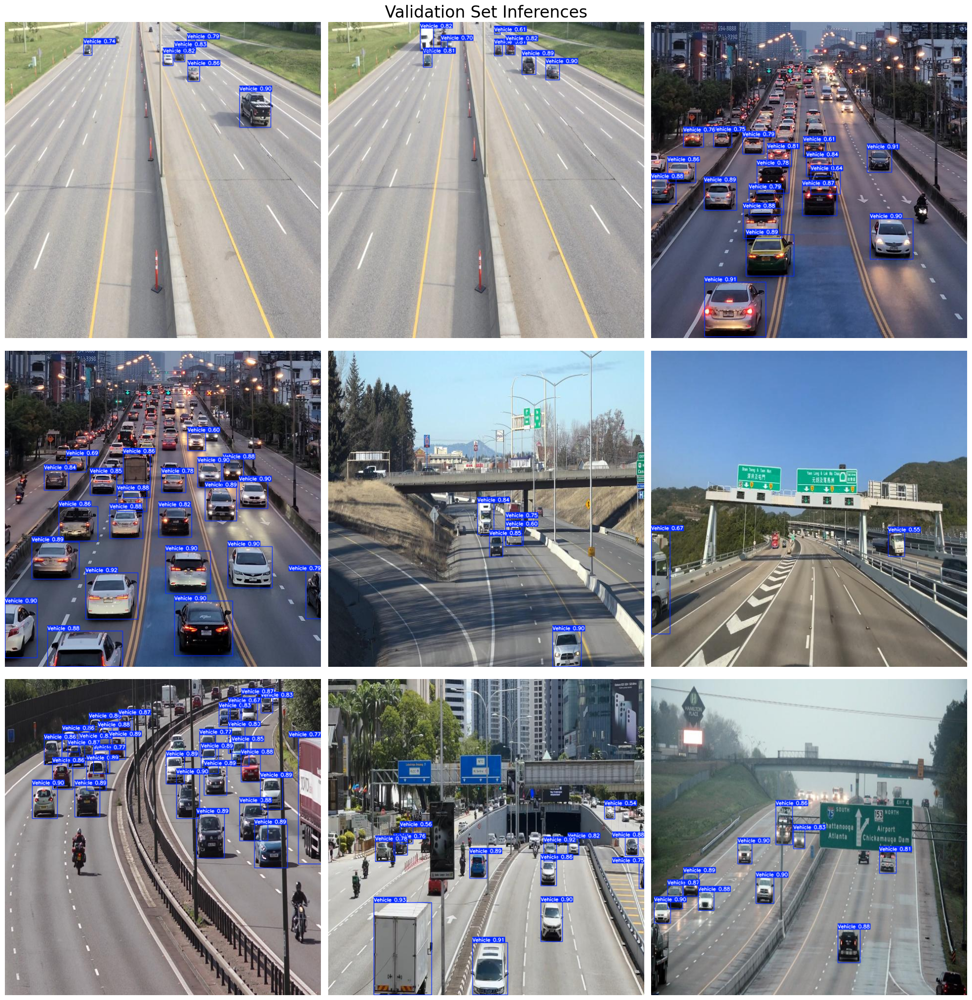

In [12]:
# Define the path to the validation images
valid_images_path = os.path.join(dataset_path, 'valid', 'images')

# List all jpg images in the directory
image_files = [file for file in os.listdir(valid_images_path) if file.endswith('.jpg')]

# Select 9 images at equal intervals
num_images = len(image_files)
selected_images = [image_files[i] for i in range(0, num_images, num_images // 9)]

# Initialize the subplot
fig, axes = plt.subplots(3, 3, figsize=(20, 21))
fig.suptitle('Validation Set Inferences', fontsize=24)

# Perform inference on each selected image and display it
for i, ax in enumerate(axes.flatten()):
    image_path = os.path.join(valid_images_path, selected_images[i])
    results = best_model.predict(source=image_path, imgsz=640, conf=0.5)
    annotated_image = results[0].plot(line_width=1)
    annotated_image_rgb = cv2.cvtColor(annotated_image, cv2.COLOR_BGR2RGB)
    ax.imshow(annotated_image_rgb)
    ax.axis('off')

plt.tight_layout()
plt.show()


image 1/1 /Users/kakuryu/my_project_dir/Traffic Detection/images/sample_image.jpg: 384x640 11 Vehicles, 59.4ms
Speed: 2.3ms preprocess, 59.4ms inference, 0.3ms postprocess per image at shape (1, 3, 384, 640)


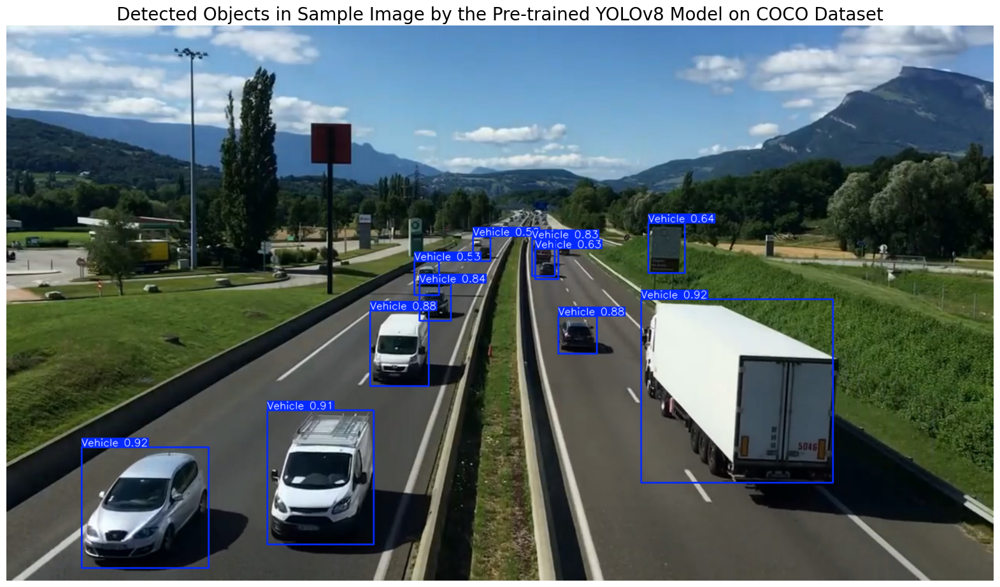

In [13]:
# Path to the image file
image_path = '/Users/kakuryu/my_project_dir/Traffic Detection/images/sample_image.jpg'

# Perform inference on the provided image(s)
results = best_model.predict(source=image_path, 
                        imgsz=640,  # Resize image to 640x640 (the size pf images the model was trained on)
                        conf=0.5)   # Confidence threshold: 50% (only detections above 50% confidence will be considered)

# Annotate and convert image to numpy array
sample_image = results[0].plot(line_width=2)

# Convert the color of the image from BGR to RGB for correct color representation in matplotlib
sample_image = cv2.cvtColor(sample_image, cv2.COLOR_BGR2RGB)

# Display annotated image
plt.figure(figsize=(20,15))
plt.imshow(sample_image)
plt.title('Detected Objects in Sample Image by the Pre-trained YOLOv8 Model on COCO Dataset', fontsize=20)
plt.axis('off')
plt.show()


image 1/1 /Users/kakuryu/my_project_dir/Traffic Detection/images/sample_image5.jpg: 384x640 5 Vehicles, 42.6ms
Speed: 1.7ms preprocess, 42.6ms inference, 0.3ms postprocess per image at shape (1, 3, 384, 640)


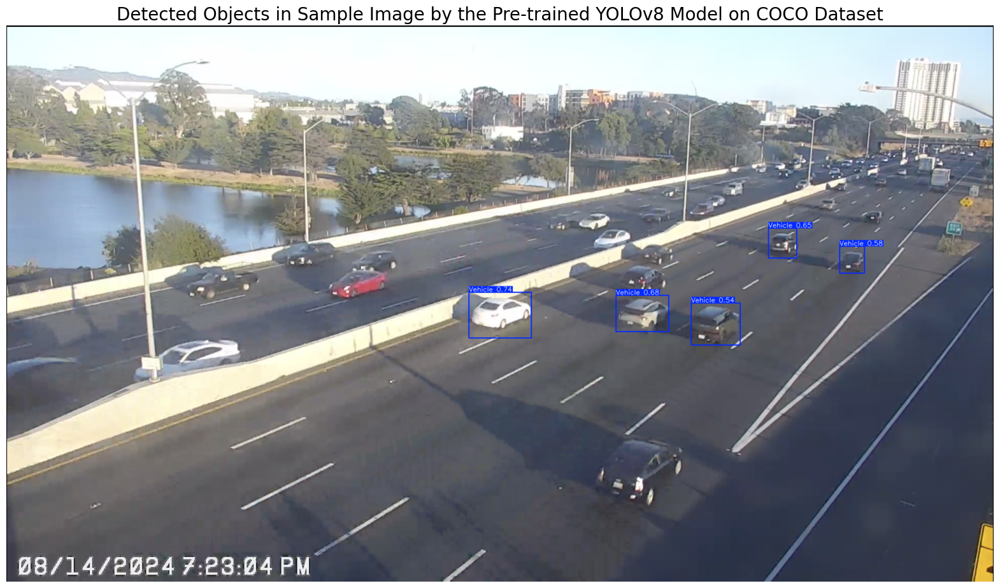

In [14]:
# Path to the image file
image_path = '/Users/kakuryu/my_project_dir/Traffic Detection/images/sample_image5.jpg'

# Perform inference on the provided image(s)
results = best_model.predict(source=image_path, 
                        imgsz=640,  # Resize image to 640x640 (the size pf images the model was trained on)
                        conf=0.5)   # Confidence threshold: 50% (only detections above 50% confidence will be considered)

# Annotate and convert image to numpy array
sample_image = results[0].plot(line_width=2)

# Convert the color of the image from BGR to RGB for correct color representation in matplotlib
sample_image = cv2.cvtColor(sample_image, cv2.COLOR_BGR2RGB)

# Display annotated image
plt.figure(figsize=(20,15))
plt.imshow(sample_image)
plt.title('Detected Objects in Sample Image by the Pre-trained YOLOv8 Model on COCO Dataset', fontsize=20)
plt.axis('off')
plt.show()

In [15]:
# Define the path to the sample video in the dataset
dataset_video_path = '/Users/kakuryu/my_project_dir/Traffic Detection/sample_video.mp4'

#Define the destination path in the working directory
video_path = 'sample_video.mp4'

#Copy the video file from its original location in the dataset to the current working directory in Kaggle for further processing
shutil.copyfile(dataset_video_path, video_path)

# Initiate vehicle detection on the sample video using the best performing model and save the output
best_model.predict(source=video_path, save=True)

SameFileError: '/Users/kakuryu/my_project_dir/Traffic Detection/sample_video.mp4' and 'sample_video.mp4' are the same file

In [154]:
# Convert the .avi video generated by the YOLOv8 prediction to .mp4 format for compatibility with notebook display
!!/Users/kakuryu/my_project_dir/Traffic Detection/ffmpeg -y -loglevel panic -i /kakuryu/my_project_dir/Traffic Detection/runs/detect/predict/sample_video.avi processed_sample_video.mp4

In [162]:
# Display the video
Video(video_path, embed=True, width=960)

In [155]:
# Define the threshold for considering traffic as heavy
heavy_traffic_threshold = 10

# Define the vertices for the quadrilaterals
vertices1 = np.array([(465, 350), (609, 350), (510, 630), (2, 630)], dtype=np.int32)
vertices2 = np.array([(678, 350), (815, 350), (1203, 630), (743, 630)], dtype=np.int32)

# Define the vertical range for the slice and lane threshold
x1, x2 = 325, 635 
lane_threshold = 609

# Define the positions for the text annotations on the image
text_position_left_lane = (10, 50)
text_position_right_lane = (820, 50)
intensity_position_left_lane = (10, 100)
intensity_position_right_lane = (820, 100)

# Define font, scale, and colors for the annotations
font = cv2.FONT_HERSHEY_SIMPLEX
font_scale = 1
font_color = (255, 255, 255)    # White color for text
background_color = (0, 0, 255)  # Red background for text
        
# Open the video
cap = cv2.VideoCapture('sample_video.mp4')

# Define the codec and create VideoWriter object
fourcc = cv2.VideoWriter_fourcc(*'XVID')
out = cv2.VideoWriter('traffic_density_analysis.avi', fourcc, 20.0, (int(cap.get(3)), int(cap.get(4))))

# Read until video is completed
while cap.isOpened():
    # Capture frame-by-frame
    ret, frame = cap.read()
    if ret:
        # Create a copy of the original frame to modify
        detection_frame = frame.copy()
    
        # Black out the regions outside the specified vertical range
        detection_frame[:x1, :] = 0  # Black out from top to x1
        detection_frame[x2:, :] = 0  # Black out from x2 to the bottom of the frame
        
        # Perform inference on the modified frame
        results = best_model.predict(detection_frame, imgsz=640, conf=0.4)
        processed_frame = results[0].plot(line_width=1)
        
        # Restore the original top and bottom parts of the frame
        processed_frame[:x1, :] = frame[:x1, :].copy()
        processed_frame[x2:, :] = frame[x2:, :].copy()        
        
        # Draw the quadrilaterals on the processed frame
        cv2.polylines(processed_frame, [vertices1], isClosed=True, color=(0, 255, 0), thickness=2)
        cv2.polylines(processed_frame, [vertices2], isClosed=True, color=(255, 0, 0), thickness=2)
        
        # Retrieve the bounding boxes from the results
        bounding_boxes = results[0].boxes

        # Initialize counters for vehicles in each lane
        vehicles_in_left_lane = 0
        vehicles_in_right_lane = 0

        # Loop through each bounding box to count vehicles in each lane
        for box in bounding_boxes.xyxy:
            # Check if the vehicle is in the left lane based on the x-coordinate of the bounding box
            if box[0] < lane_threshold:
                vehicles_in_left_lane += 1
            else:
                vehicles_in_right_lane += 1
                
        # Determine the traffic intensity for the left lane
        traffic_intensity_left = "Heavy" if vehicles_in_left_lane > heavy_traffic_threshold else "Smooth"
        # Determine the traffic intensity for the right lane
        traffic_intensity_right = "Heavy" if vehicles_in_right_lane > heavy_traffic_threshold else "Smooth"


        # Add a background rectangle for the left lane vehicle count
        cv2.rectangle(processed_frame, (text_position_left_lane[0]-10, text_position_left_lane[1] - 25), 
                      (text_position_left_lane[0] + 460, text_position_left_lane[1] + 10), background_color, -1)

        # Add the vehicle count text on top of the rectangle for the left lane
        cv2.putText(processed_frame, f'Vehicles in Left Lane: {vehicles_in_left_lane}', text_position_left_lane, 
                    font, font_scale, font_color, 2, cv2.LINE_AA)

        # Add a background rectangle for the left lane traffic intensity
        cv2.rectangle(processed_frame, (intensity_position_left_lane[0]-10, intensity_position_left_lane[1] - 25), 
                      (intensity_position_left_lane[0] + 460, intensity_position_left_lane[1] + 10), background_color, -1)

        # Add the traffic intensity text on top of the rectangle for the left lane
        cv2.putText(processed_frame, f'Traffic Intensity: {traffic_intensity_left}', intensity_position_left_lane, 
                    font, font_scale, font_color, 2, cv2.LINE_AA)

        # Add a background rectangle for the right lane vehicle count
        cv2.rectangle(processed_frame, (text_position_right_lane[0]-10, text_position_right_lane[1] - 25), 
                      (text_position_right_lane[0] + 460, text_position_right_lane[1] + 10), background_color, -1)

        # Add the vehicle count text on top of the rectangle for the right lane
        cv2.putText(processed_frame, f'Vehicles in Right Lane: {vehicles_in_right_lane}', text_position_right_lane, 
                    font, font_scale, font_color, 2, cv2.LINE_AA)

        # Add a background rectangle for the right lane traffic intensity
        cv2.rectangle(processed_frame, (intensity_position_right_lane[0]-10, intensity_position_right_lane[1] - 25), 
                      (intensity_position_right_lane[0] + 460, intensity_position_right_lane[1] + 10), background_color, -1)

        # Add the traffic intensity text on top of the rectangle for the right lane
        cv2.putText(processed_frame, f'Traffic Intensity: {traffic_intensity_right}', intensity_position_right_lane, 
                    font, font_scale, font_color, 2, cv2.LINE_AA)

        # Write the processed frame to the output video
        out.write(processed_frame)
        
        # Uncomment the following 3 lines if running this code on a local machine to view the real-time processing results
        # cv2.imshow('Real-time Analysis', processed_frame)
        # if cv2.waitKey(1) & 0xFF == ord('q'):  # Press Q on keyboard to exit the loop
        #     break
    else:
        break

# Release the video capture and video write objects
cap.release()
out.release()

# Close all the frames
# cv2.destroyAllWindows()


0: 384x640 (no detections), 62.3ms
Speed: 2.7ms preprocess, 62.3ms inference, 0.3ms postprocess per image at shape (1, 3, 384, 640)

0: 384x640 (no detections), 52.0ms
Speed: 1.1ms preprocess, 52.0ms inference, 0.2ms postprocess per image at shape (1, 3, 384, 640)

0: 384x640 (no detections), 48.3ms
Speed: 1.8ms preprocess, 48.3ms inference, 0.2ms postprocess per image at shape (1, 3, 384, 640)

0: 384x640 (no detections), 41.7ms
Speed: 2.3ms preprocess, 41.7ms inference, 0.2ms postprocess per image at shape (1, 3, 384, 640)

0: 384x640 (no detections), 43.3ms
Speed: 1.4ms preprocess, 43.3ms inference, 0.2ms postprocess per image at shape (1, 3, 384, 640)

0: 384x640 (no detections), 50.9ms
Speed: 2.0ms preprocess, 50.9ms inference, 0.2ms postprocess per image at shape (1, 3, 384, 640)

0: 384x640 (no detections), 46.5ms
Speed: 1.0ms preprocess, 46.5ms inference, 0.2ms postprocess per image at shape (1, 3, 384, 640)

0: 384x640 (no detections), 41.4ms
Speed: 1.1ms preprocess, 41.4ms i

In [169]:
# Convert the .avi video generated by our traffic density estimation app to .mp4 format for compatibility with notebook display
!!/Users/kakuryu/my_project_dir/Traffic Detection/ffmpeg -y -loglevel panic -i /kaggle/working/traffic_density_analysis.avi traffic_density_analysis.mp4

# Embed and display the processed sample video within the notebook
Video("traffic_density_analysis.mp4", embed=True, width=960)

In [ ]:
Video(video_path, embed=True, width=960)

In [18]:
!git clone https://github.com/mid9t/Bay-Bridge-Transit-Time

Cloning into 'Bay-Bridge-Transit-Time'...
remote: Enumerating objects: 13, done.
remote: Counting objects: 100% (13/13), done.
remote: Compressing objects: 100% (11/11), done.
remote: Total 13 (delta 1), reused 0 (delta 0), pack-reused 0 (from 0)
Receiving objects: 100% (13/13), 19.53 MiB | 26.11 MiB/s, done.
Resolving deltas: 100% (1/1), done.


In [21]:
!git add .
!git commit -m "initial commit"
!git push origin master

fatal: not a git repository (or any of the parent directories): .git
fatal: not a git repository (or any of the parent directories): .git
fatal: not a git repository (or any of the parent directories): .git
